In [63]:
import pandas as pd
import numpy as np
import seaborn as sns
import os

In [64]:
os.listdir()
os.chdir(r"C:\Users\RYZEN\logistic-optimization")
os.listdir()


['.dvc',
 '.dvcignore',
 '.git',
 'data',
 'notebooks',
 'README.md',
 'screenshots',
 'scripts',
 'tests']

In [65]:
trips_df= pd.read_csv('data/nb.csv')

In [66]:
trips_df.head()

,trip_id,trip_origin,trip_destination,trip_start_time,trip_end_time
0,391996,"6.508813001668548,3.37740316890347","6.650969799999999,3.3450307",7/1/2021 7:28,7/1/2021 7:29
1,391997,"6.4316714,3.4555375","6.4280814653326,3.4721885847586",7/1/2021 6:38,7/1/2021 7:07
2,391998,"6.631679399999999,3.3388976","6.508324099999999,3.3590397",7/1/2021 6:21,7/1/2021 7:02
3,391999,"6.572757200000001,3.3677082","6.584881099999999,3.3614073",7/1/2021 7:16,7/1/2021 7:29
4,392001,"6.6010417,3.2766339","6.4501069,3.3916154",7/1/2021 9:30,7/1/2021 9:34


In [67]:
trips_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 536020 entries, 0 to 536019
Data columns (total 5 columns):
 #   Column            Non-Null Count   Dtype 
---  ------            --------------   ----- 
 0   trip_id           536020 non-null  int64 
 1   trip_origin       536020 non-null  object
 2   trip_destination  536020 non-null  object
 3   trip_start_time   534369 non-null  object
 4   trip_end_time     536019 non-null  object
dtypes: int64(1), object(4)
memory usage: 20.4+ MB


In [68]:
# checking missing value
trips_df.isna().sum()

trip_id                0
trip_origin            0
trip_destination       0
trip_start_time     1651
trip_end_time          1
dtype: int64

## VISUALIZE TRIPS

In [69]:
import datashader as ds
import datashader.transfer_functions as dtf
from datashader.colors import colormap_select as cm, inferno, viridis
from datashader.utils import lnglat_to_meters

import matplotlib as mpl
import matplotlib.pyplot as plt

import numpy as np
import pandas as pd
import seaborn as sns

from IPython.display import display, HTML
from matplotlib.colors import LinearSegmentedColormap

# Datashader helper function:
def bg(img): return dtf.set_background(img, "black")

%matplotlib inline
mpl.rcParams['figure.dpi'] = 130

In [70]:
# def convert_to_datetime(self, df:pd.DataFrame)->pd.DataFrame
# convert column to datetime
trips_df['trip_start_time']=pd.to_datetime(trips_df['trip_start_time'])        
trips_df['trip_end_time']=pd.to_datetime(trips_df['trip_end_time'])        


In [71]:
hourly_counts = trips_df.set_index('trip_start_time').resample('1h').size().reset_index(name='trips')
hourly_counts['date'] = hourly_counts.trip_start_time.dt.strftime("%b %d %Y")
hourly_counts['hour'] = hourly_counts.trip_start_time.dt.hour
hourly_counts['DoW'] = hourly_counts.trip_start_time.dt.dayofweek
hourly_counts.head()

,trip_start_time,trips,date,hour,DoW
0,2021-07-01 06:00:00,6,Jul 01 2021,6,3
1,2021-07-01 07:00:00,37,Jul 01 2021,7,3
2,2021-07-01 08:00:00,128,Jul 01 2021,8,3
3,2021-07-01 09:00:00,233,Jul 01 2021,9,3
4,2021-07-01 10:00:00,297,Jul 01 2021,10,3


c:\Users\RYZEN\anaconda3\envs\py37\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The tsplot function is deprecated and will be removed or replaced (in a substantially altered version) in a future release.
  warnings.warn(msg, UserWarning)


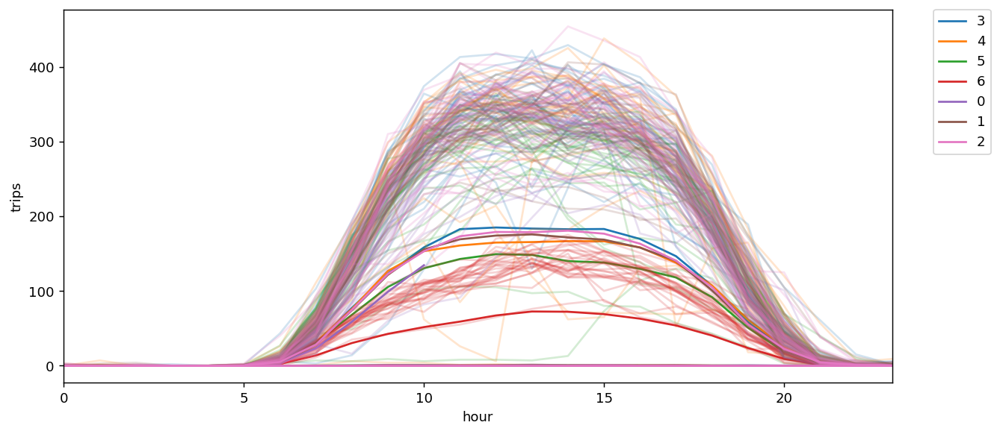

In [72]:
plt.figure(figsize=(11, 5))
sns.tsplot(time="hour", value="trips", unit="date", condition='DoW', data=hourly_counts, err_style="unit_traces", )
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);

How Most trips always start from the 6th hour of the day and peaks at midday or noon and the trips start reducing until 8pm in the evening Nigerian time.

In [73]:
#splitting cordinates column from x,y to x ad y
trips_df['trip_origin_lat'] = trips_df['trip_origin'].apply(lambda x: str(x).split(',')[0])
trips_df['trip_origin_lng'] = trips_df['trip_origin'].apply(lambda x: str(x).split(',')[1])

In [74]:
#splitting cordinates column from x,y to x ad y
trips_df['trip_destination_lat'] = trips_df['trip_destination'].apply(lambda x: str(x).split(',')[0])
trips_df['trip_destination_lng'] = trips_df['trip_destination'].apply(lambda x: str(x).split(',')[1])

In [75]:
trips_df.head()

,trip_id,trip_origin,trip_destination,trip_start_time,trip_end_time,trip_origin_lat,trip_origin_lng,trip_destination_lat,trip_destination_lng
0,391996,"6.508813001668548,3.37740316890347","6.650969799999999,3.3450307",2021-07-01 07:28:00,2021-07-01 07:29:00,6.508813001668548,3.37740316890347,6.650969799999999,3.3450307
1,391997,"6.4316714,3.4555375","6.4280814653326,3.4721885847586",2021-07-01 06:38:00,2021-07-01 07:07:00,6.4316714,3.4555375,6.4280814653326,3.4721885847586
2,391998,"6.631679399999999,3.3388976","6.508324099999999,3.3590397",2021-07-01 06:21:00,2021-07-01 07:02:00,6.631679399999999,3.3388976,6.508324099999999,3.3590397
3,391999,"6.572757200000001,3.3677082","6.584881099999999,3.3614073",2021-07-01 07:16:00,2021-07-01 07:29:00,6.572757200000001,3.3677082,6.584881099999999,3.3614073
4,392001,"6.6010417,3.2766339","6.4501069,3.3916154",2021-07-01 09:30:00,2021-07-01 09:34:00,6.6010417,3.2766339,6.4501069,3.3916154


In [76]:
trips_df.to_csv('data/extract_trips.csv', index=False)


**Pickup and dropoff locations distribution**

- blue : pickup locations
- yellow : dropoff locations


In [77]:
import datashader as ds
import pandas as pd
import colorcet as cc
import holoviews as hv
from holoviews.element.tiles import EsriImagery
from holoviews.operation.datashader import datashade

Now let’s create a basic visualization to represent all the orders points accordingly on a canvas. We will paint the canvas black and show all the data points there at their exact location.

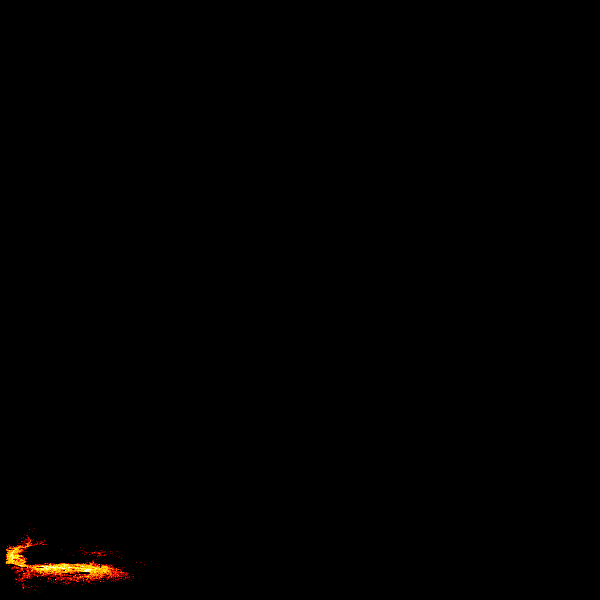

In [78]:
agg = ds.Canvas().points(orders_df, 'lat', 'lng')
ds.tf.set_background(ds.tf.shade(agg, cmap=cc.fire), "black")


Now to plot it on  a map using Holoviews and Bokeh

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
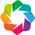

:DynamicMap   []
   :Overlay
      .Tiles.I :Tiles   [x,y]
      .RGB.I   :RGB   [x,y]   (R,G,B,A)

In [79]:
hv.extension('bokeh')
points = hv.Points(ds.utils.lnglat_to_meters(orders_df['lng'], orders_df['lat']))
map_tiles  = EsriImagery().opts(alpha=1.1, width=900, height=800, bgcolor='black')
taxi_trips = datashade(points, x_sampling=3, y_sampling=3, cmap=cc.fire, width=3000, height=480)
map_tiles * taxi_trips

The output https://github.com/MegCheppy/logistic-optimization/blob/b8748ea01a7623d13d9e62ee41ad7954997b9b69/bokeh_plot.png shows the distribution of order locations, and we can tell where most orders are coming from on the map, which is the darker-shaded areas.

## FOLIUM VISUALIZATION

In [91]:
import pandas as pd
import folium
from folium.plugins import HeatMap
from folium.plugins import HeatMapWithTime

In [101]:
def generateBaseMap(default_location=[6.45407,3.39467], default_zoom_start=11):
    """
    location: Define the default location to zoom at when rendering the map
    zoom_start: The zoom level that the map will default to when rendering the map
    control_scale: Shows the map scale for a given zoom level
    """
    base_map = folium.Map(location=default_location, control_scale=True, zoom_start=default_zoom_start)
    return base_map

In [103]:
base_map = generateBaseMap()
base_map

In [111]:
#Extract datetime
trips_df.trip_start_time = pd.to_datetime(trips_df.trip_start_time, format='%Y-%m-%d %H:%M:%S')
trips_df['month'] = trips_df.trip_start_time.apply(lambda x: x.month)
trips_df['week'] = trips_df.trip_start_time.apply(lambda x: x.week)
trips_df['day'] = trips_df.trip_start_time.apply(lambda x: x.day)
trips_df['hour'] = trips_df.trip_start_time.apply(lambda x: x.hour)
trips_df.head()

,trip_id,trip_origin,trip_destination,trip_start_time,trip_end_time,trip_origin_lat,trip_origin_lng,trip_destination_lat,trip_destination_lng,month,week,day,hour
0,391996,"6.508813001668548,3.37740316890347","6.650969799999999,3.3450307",2021-07-01 07:28:00,2021-07-01 07:29:00,6.508813001668548,3.37740316890347,6.650969799999999,3.3450307,7.0,26.0,1.0,7.0
1,391997,"6.4316714,3.4555375","6.4280814653326,3.4721885847586",2021-07-01 06:38:00,2021-07-01 07:07:00,6.4316714,3.4555375,6.4280814653326,3.4721885847586,7.0,26.0,1.0,6.0
2,391998,"6.631679399999999,3.3388976","6.508324099999999,3.3590397",2021-07-01 06:21:00,2021-07-01 07:02:00,6.631679399999999,3.3388976,6.508324099999999,3.3590397,7.0,26.0,1.0,6.0
3,391999,"6.572757200000001,3.3677082","6.584881099999999,3.3614073",2021-07-01 07:16:00,2021-07-01 07:29:00,6.572757200000001,3.3677082,6.584881099999999,3.3614073,7.0,26.0,1.0,7.0
4,392001,"6.6010417,3.2766339","6.4501069,3.3916154",2021-07-01 09:30:00,2021-07-01 09:34:00,6.6010417,3.2766339,6.4501069,3.3916154,7.0,26.0,1.0,9.0


In [113]:
# We will be using 2 months worth of data for this analysis.
df_copy = trips_df[trips_df.month>0].copy()
df_copy['count'] = 1

In [114]:
df_copy[['trip_origin_lat', 'trip_origin_lng', 'count']].groupby(['trip_origin_lat', 'trip_origin_lng']).sum().sort_values('count', ascending=False).head(10)

,,count
trip_origin_lat,trip_origin_lng,
6.6137933,3.357997,865
6.462727,3.55679,668
6.4293597,3.4334968,576
6.4286308,3.5155123,544
6.622069799999999,3.383825,538
6.4440858,3.5080498,537
6.4431192,3.4814372,534
6.5952581,3.3521434,522
6.452345299999999,3.527539,520


In [115]:
# From the dataframe above, it can be clearly seen that using tables to try to understand spatial data is an impossible task (duh)
base_map = generateBaseMap()
HeatMap(data=df_copy[['trip_origin_lat', 'trip_origin_lng', 'count']].groupby(['trip_origin_lat', 'trip_origin_lng']).sum().reset_index().values.tolist(), radius=8, max_zoom=13).add_to(base_map)


In [116]:
base_map

The heatmap above shows area where most requests are located, therefore shows where drivers need to be adviced to wait for requests.

In [118]:
#We aregoing to add markers to suggest potential locations.
base_map.add_child(folium.ClickForMarker(popup='Potential Location'))

Let's add a time factor, to map requests vs time.

In [119]:
df_hour_list = []
for hour in df_copy.hour.sort_values().unique():
    df_hour_list.append(df_copy.loc[df_copy.hour == hour, ['trip_origin_lat', 'trip_origin_lng', 'count']].groupby(['trip_origin_lat', 'trip_origin_lng']).sum().reset_index().values.tolist())


In [122]:
base_map = generateBaseMap(default_zoom_start=11)
HeatMapWithTime(df_hour_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map)
base_map


The animation above shows order requests in 24 hours vs location of requests.